Resolving data files:   0%|          | 0/526 [00:00<?, ?it/s]

Resolving data files:   0%|          | 0/17 [00:00<?, ?it/s]

Resolving data files:   0%|          | 0/526 [00:00<?, ?it/s]

Resolving data files:   0%|          | 0/17 [00:00<?, ?it/s]

# Verifying Mislabeling in OpenFake Dataset

---

## Sample - Viewer Index #112 | Code Index: 111

**Model:** `flux.1-dev`

**Label:** `fake`

**Prompt:** _A poster featuring a photograph of a woman feeding a child, with text at the top discussing improving nutrition for vulnerable populations as part of France's international action plan from 2016 to 2020._

**Image:**

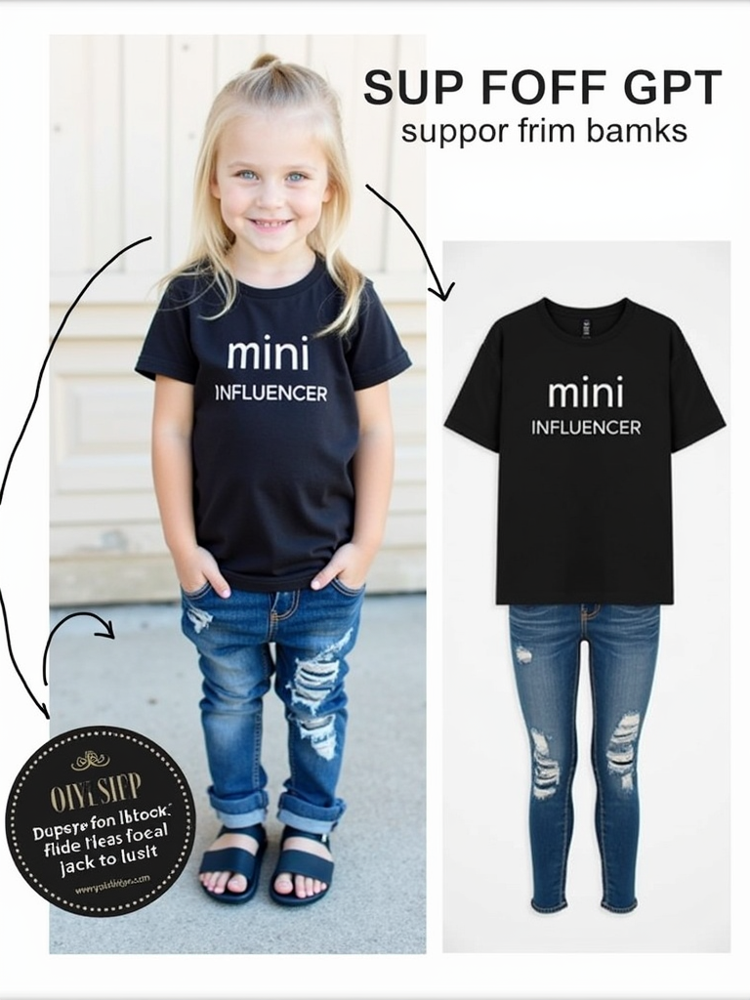

---

## Sample - Viewer Index #113 | Code Index: 112

**Model:** `sdxl-realvis-v5`

**Label:** `fake`

**Prompt:** _A poster featuring a photograph of Ronald Reagan with a hand resting on his chin against a dark background._

**Image:**

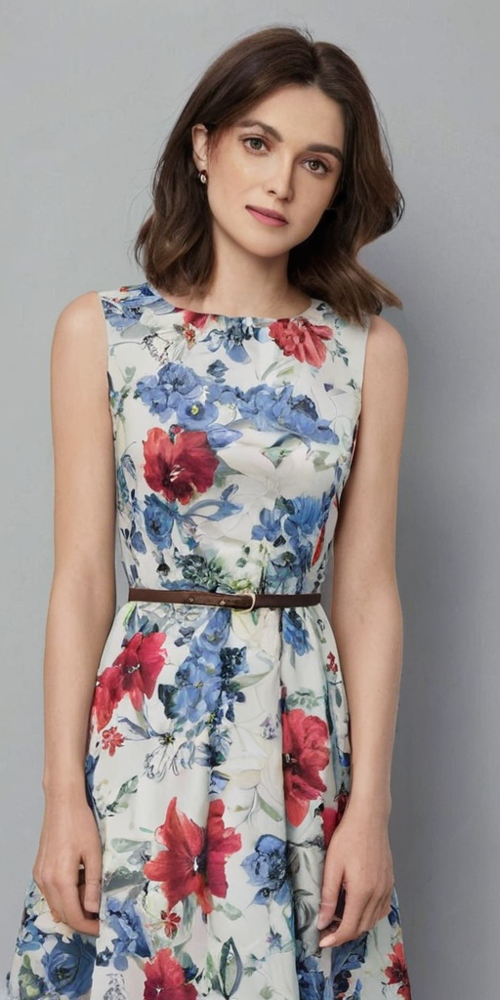

---

## Sample - Viewer Index #135 | Code Index: 134

**Model:** `sd-3.5`

**Label:** `fake`

**Prompt:** _A photograph of Jeffrey Herlings riding his KTM motorcycle on a dirt track during a motocross event, with spectators and other riders visible in the background._

**Image:**

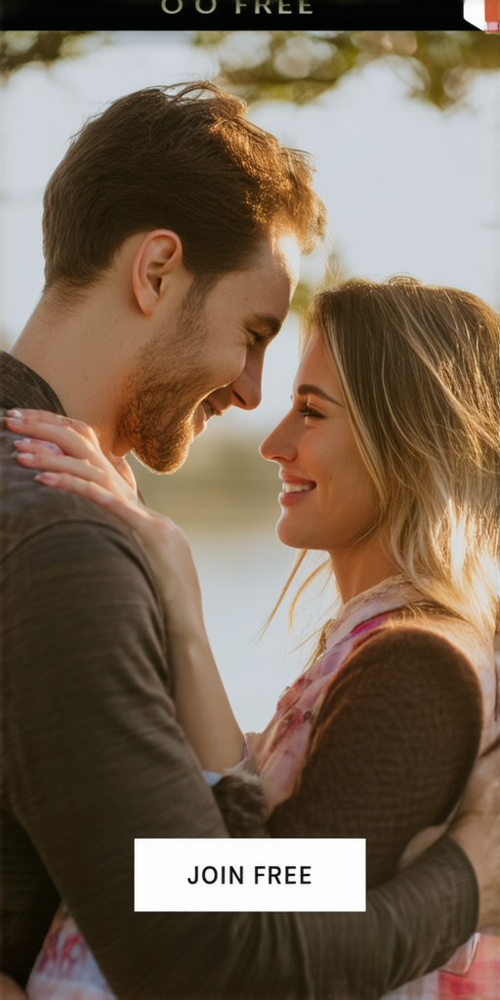

---

## Sample - Viewer Index #136 | Code Index: 135

**Model:** `flux.1-dev`

**Label:** `fake`

**Prompt:** _A dynamic basketball game moment captures Olympic's Greg Brehmer (24) attempting a shot while North Kitsap's Shaa Humphrey (23) defends, with other players and spectators in the background, all captured in a photograph._

**Image:**

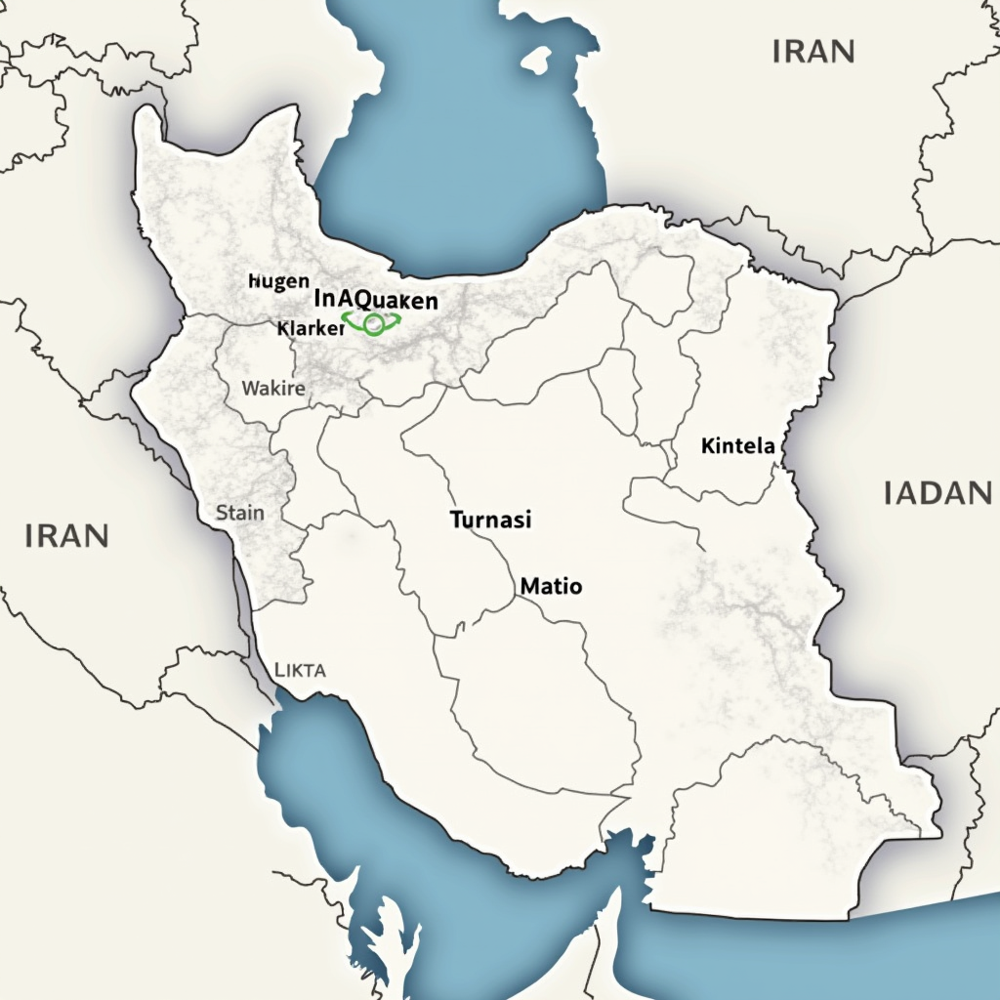

---

## Sample - Viewer Index #154 | Code Index: 153

**Model:** `sd-3.5`

**Label:** `fake`

**Prompt:** _A screenshot from "The Bureau: XCOM Declassified" featuring a character dressed in a suit and hat, set against a cityscape background._

**Image:**

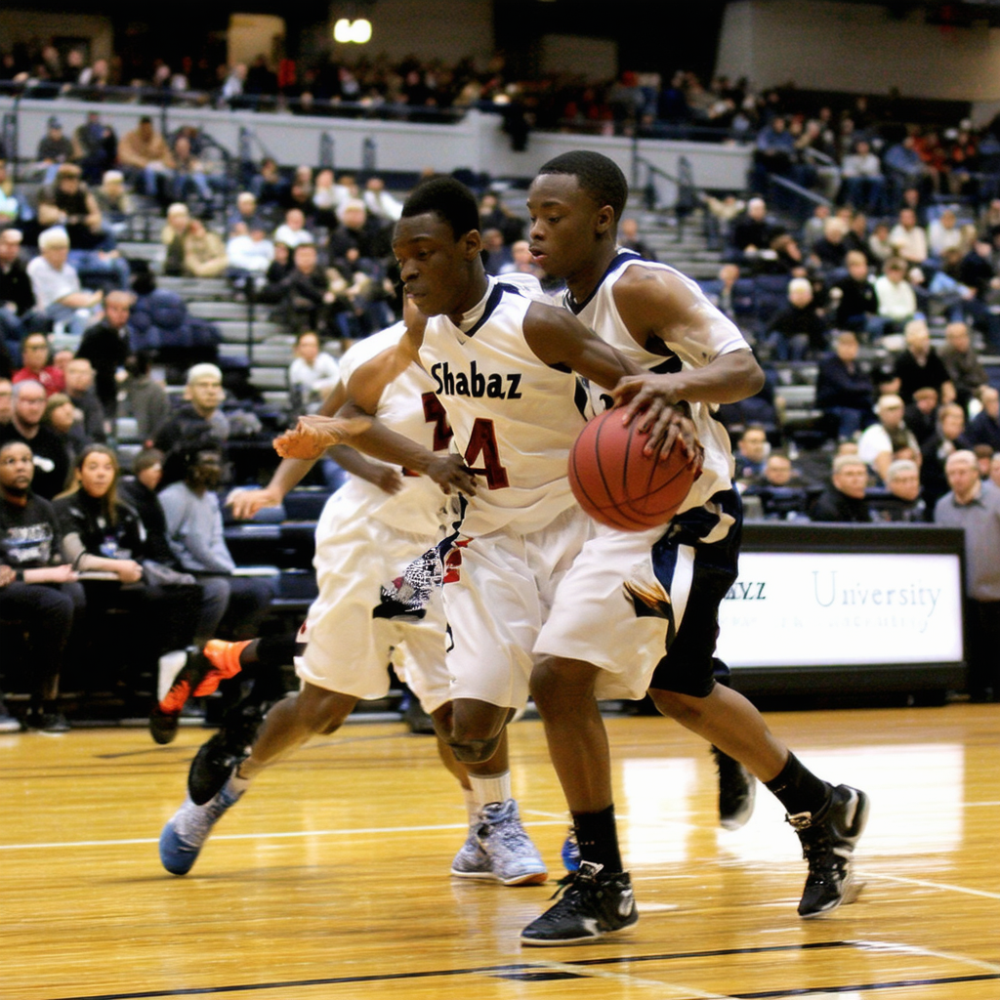

---

## Sample - Viewer Index #177 | Code Index: 176

**Model:** `sd-3.5`

**Label:** `fake`

**Prompt:** _A woman is seated in a home voiceover studio, smiling as she prepares to record, with a microphone and soundproofing visible in the background._

**Image:**

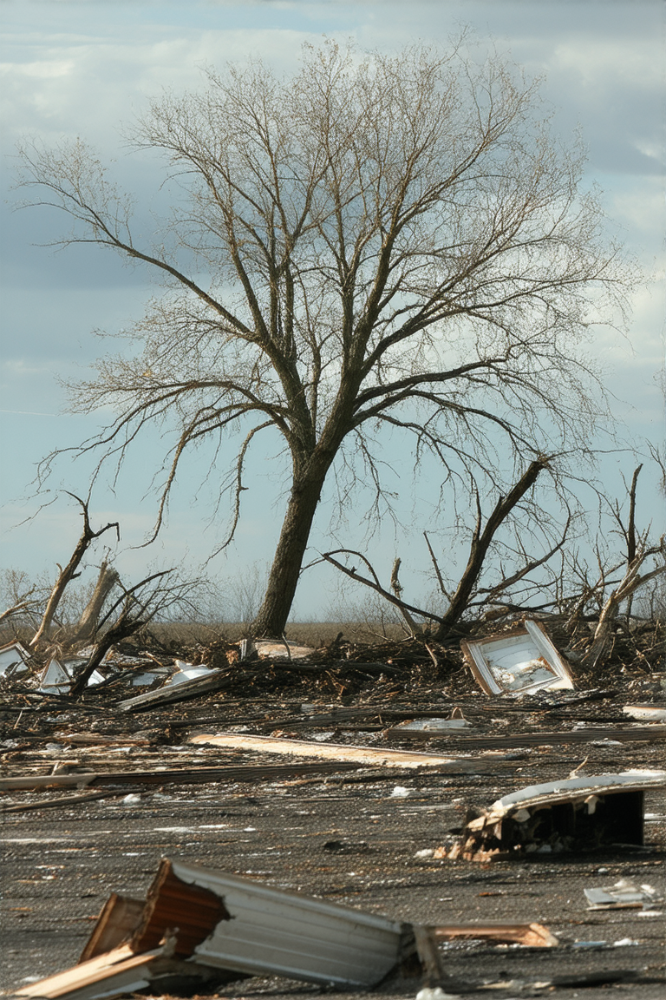

---

## Sample - Viewer Index #194 | Code Index: 193

**Model:** `sdxl-realvis-v5`

**Label:** `fake`

**Prompt:** _A young woman is sitting on steps in an urban setting, engrossed in her smartphone, with a modern building in the background, captured in high-definition stock video footage._

**Image:**

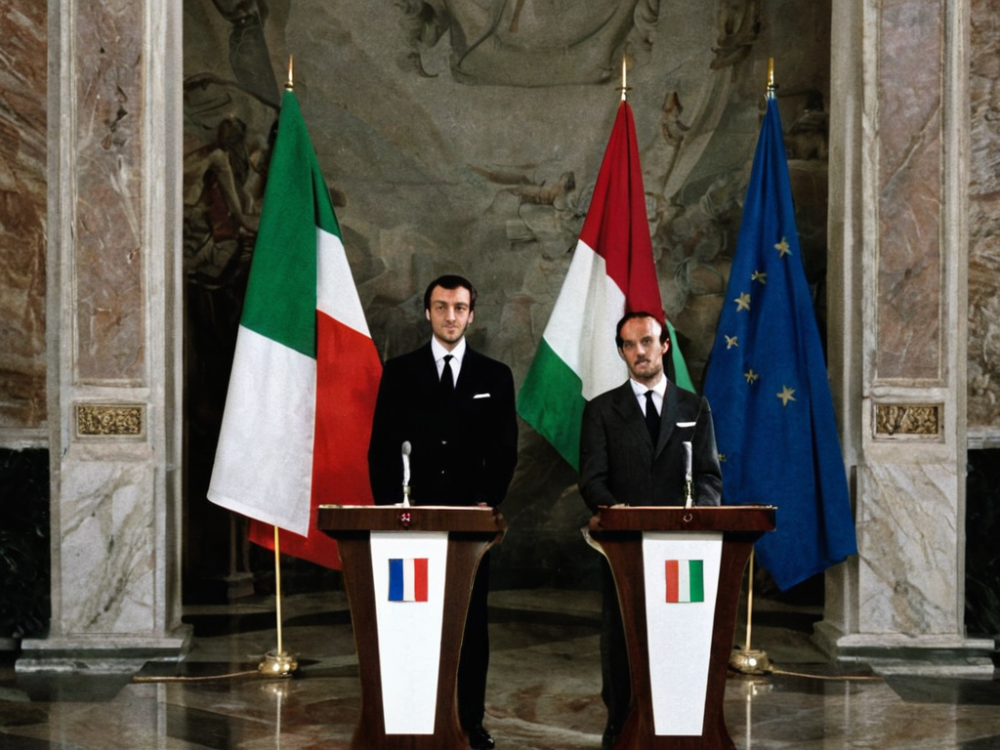

---

## Sample - Viewer Index #195 | Code Index: 194

**Model:** `flux.1-dev`

**Label:** `fake`

**Prompt:** _In a vibrant dining area, a Kent State employee smiles as a staff member prepares food at the newly branded Golden Flash Bistro, featuring Olilo by Cat Cora, with bright yellow lemons displayed prominently in the foreground._

**Image:**

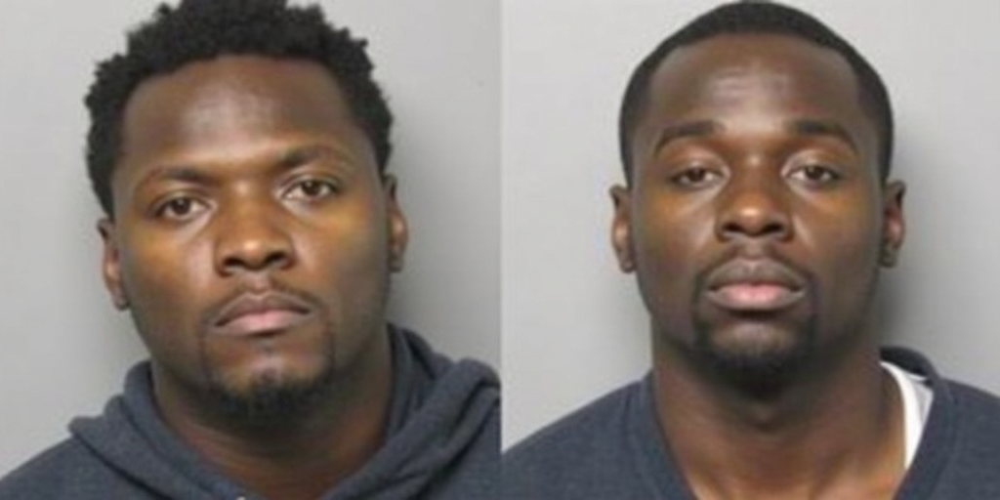

---

## Sample - Viewer Index #248 | Code Index: 247

**Model:** `sd-3.5`

**Label:** `fake`

**Prompt:** _A collage of before-and-after photographs showcasing individuals' weight loss transformations, highlighting their physical changes from overweight to fit._

**Image:**

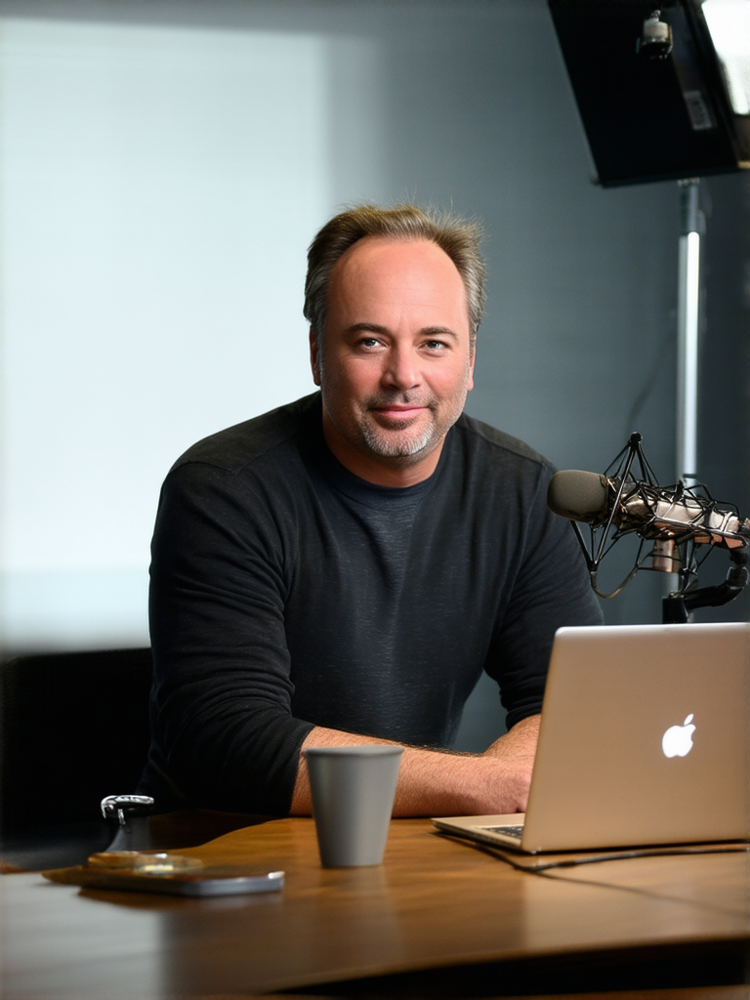

---

## Sample - Viewer Index #276 | Code Index: 275

**Model:** `flux.1-dev`

**Label:** `fake`

**Prompt:** _A magazine cover featuring Selena Gomez with a focus on her layered hoop earrings, accompanied by product details and promotional text._

**Image:**

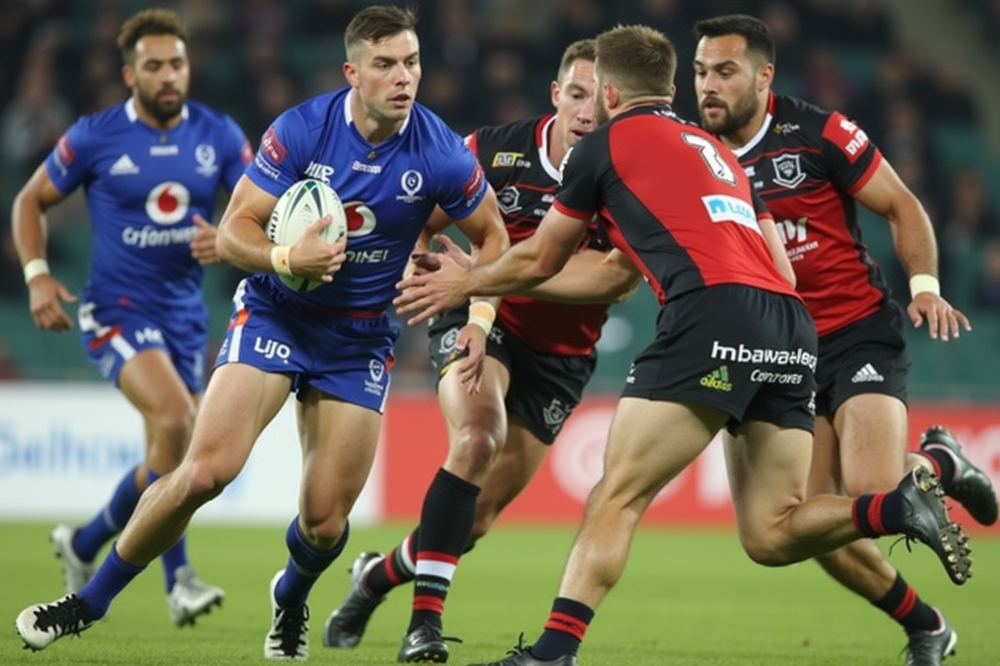

---

## Sample - Viewer Index #295 | Code Index: 294

**Model:** `sd-1.5-dreamshaper`

**Label:** `fake`

**Prompt:** _A photograph of a person holding a red rose, set against a forest backdrop, presented as a high-definition wide wallpaper suitable for widescreen displays._

**Image:**

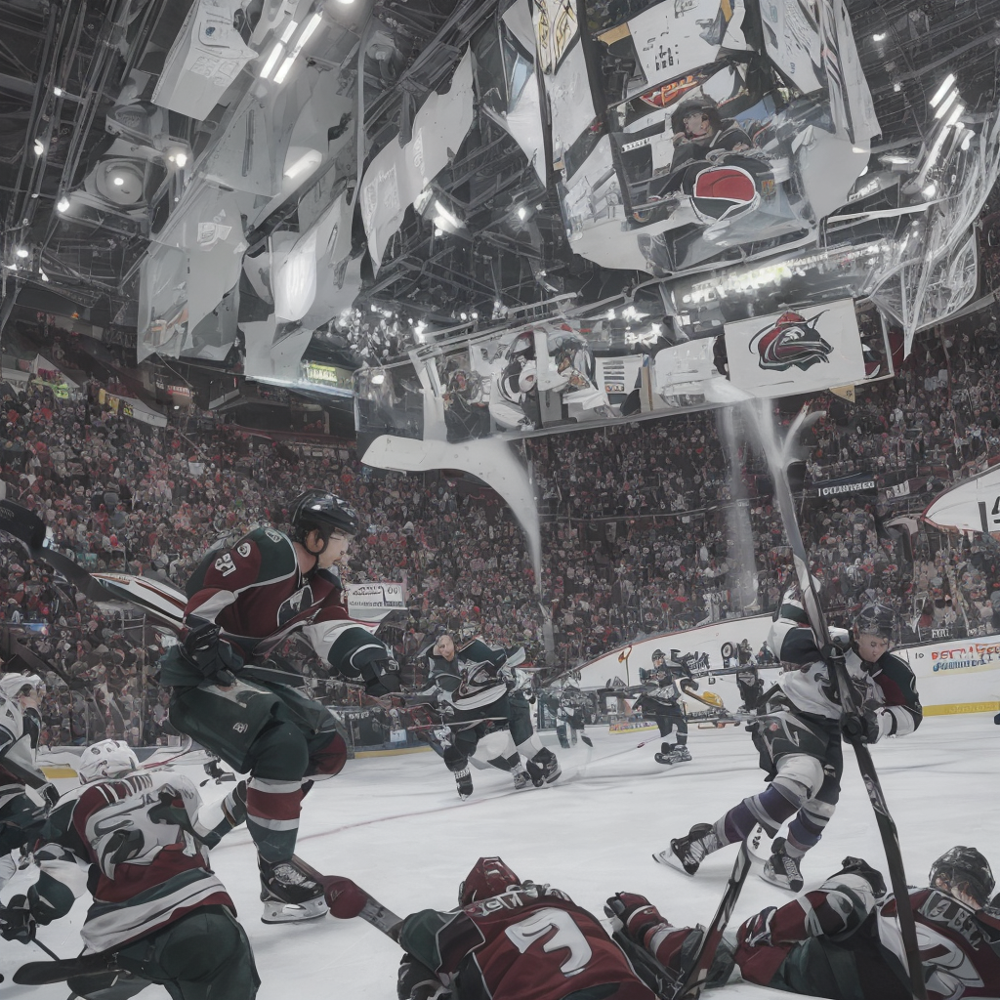

---

## Sample - Viewer Index #363 | Code Index: 362

**Model:** `sd-1.5-dreamshaper`

**Label:** `fake`

**Prompt:** _A screenshot from a news broadcast featuring a man with a beard and sunglasses, set against a backdrop of other individuals, with text and logos indicating it's from 24taas.com._

**Image:**

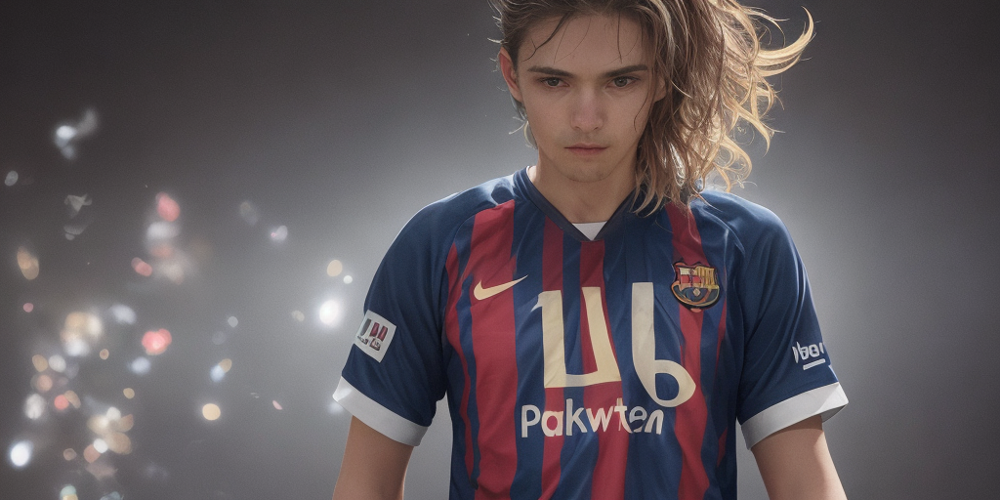

---

## Sample - Viewer Index #1250 | Code Index: 1249

**Model:** `sd-1.5-dreamshaper`

**Label:** `fake`

**Prompt:** _A collectible hockey card featuring Adrian Kempe, showcasing his rookie jersey with a limited edition number of 102 out of 399, issued by SP Game Used for the 2017/18 season._

**Image:**

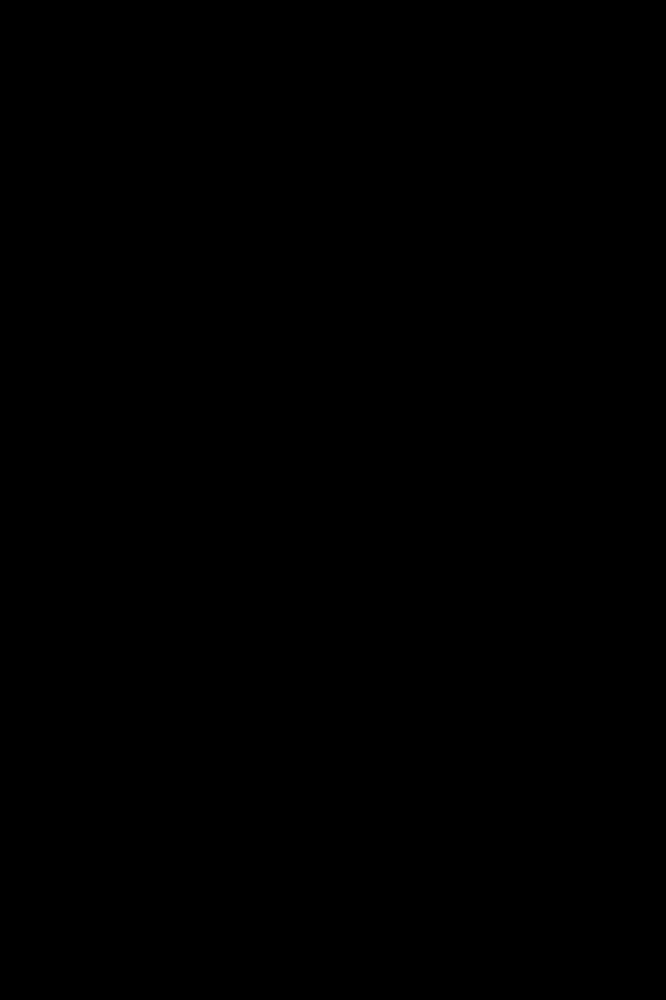

---

## Sample - Viewer Index #1651 | Code Index: 1650

**Model:** `sdxl-realvis-v5`

**Label:** `fake`

**Prompt:** _A photograph of a man standing in front of a decorative backdrop with floral arrangements, likely at an event or promotional setting._

**Image:**

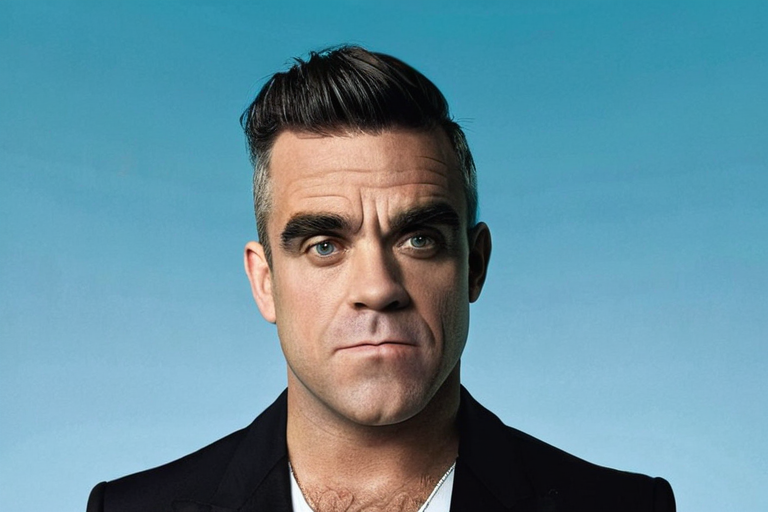

---

## Sample - Viewer Index #2614 | Code Index: 2613

**Model:** `sd-1.5-dreamshaper`

**Label:** `fake`

**Prompt:** _A photograph captures a greenhouse during Hurricane Irene on August 27, 2011, with heavy rain and wind visibly impacting the structure._

**Image:**

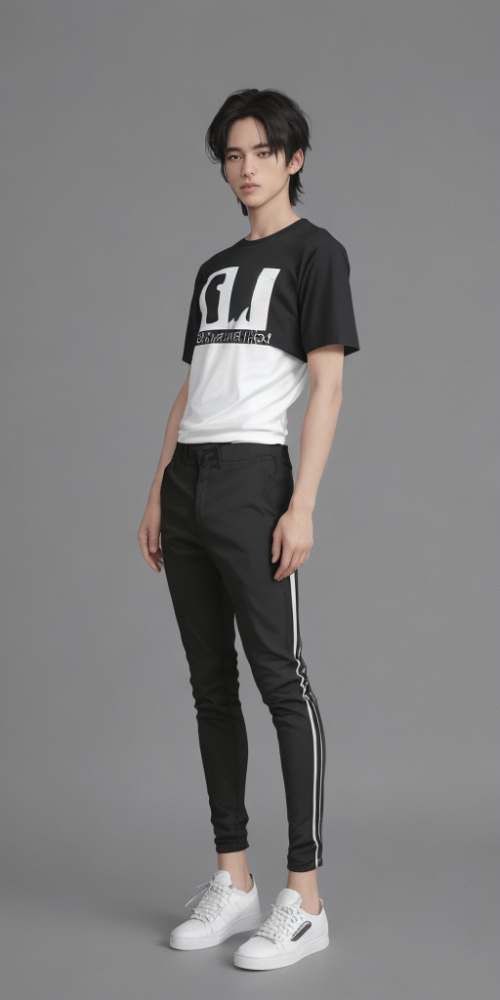

---

## Sample - Viewer Index #8077 | Code Index: 8076

**Model:** `sdxl-realvis-v5`

**Label:** `fake`

**Prompt:** _A screenshot of a news article dated October 15, 2011, at 1:04 PM CDT, featuring a woman speaking._

**Image:**

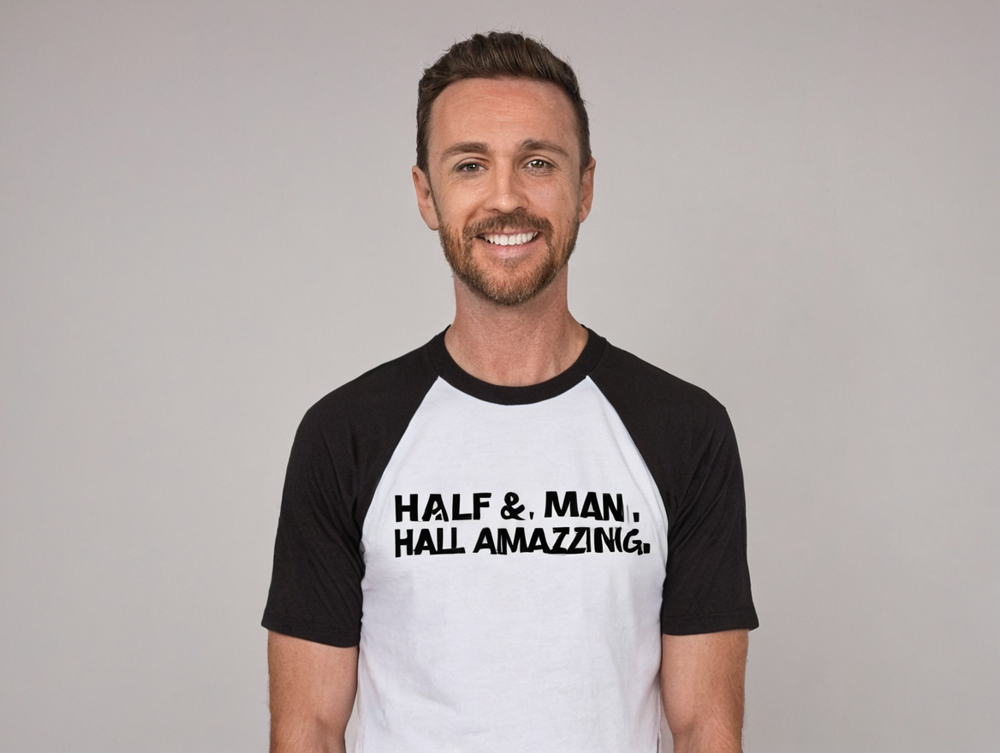

---

# Summary

**Total mislabeled samples checked:** 16

## Affected Models:

- `flux.1-dev`: 4 sample(s)

- `sd-1.5-dreamshaper`: 4 sample(s)

- `sd-3.5`: 4 sample(s)

- `sdxl-realvis-v5`: 4 sample(s)

In [1]:
from datasets import load_dataset
from IPython.display import display, Markdown
from collections import Counter

import warnings
from huggingface_hub.utils import disable_progress_bars

warnings.filterwarnings('ignore', category=UserWarning, module='huggingface_hub')
disable_progress_bars()

# HuggingFace Datasetviewer = 1-based, Code = 0-based
viewer_indices = [112, 113, 135, 136, 154, 177, 194, 195,
                                 248, 276, 295, 363,1250, 1651, 2614, 8077]

code_indices = [idx - 1 for idx in viewer_indices]

ds = load_dataset("ComplexDataLab/OpenFake", streaming=True, split="train")

display(Markdown("# Verifying Mislabeling in OpenFake Dataset"))
display(Markdown("---"))

# Track affected models
affected_models = []

for i, sample in enumerate(ds):
    if i in code_indices:
        viewer_idx = i + 1
        affected_models.append(sample['model'])

        display(Markdown(f"## Sample - Viewer Index #{viewer_idx} | Code Index: {i}"))
        display(Markdown(f"**Model:** `{sample['model']}`"))
        display(Markdown(f"**Label:** `{sample['label']}`"))
        display(Markdown(f"**Prompt:** _{sample['prompt']}_"))
        display(Markdown("**Image:**"))
        display(sample['image'])
        display(Markdown("---"))

    if i > max(code_indices):
        break

# Summary of affected models
display(Markdown("# Summary"))
display(Markdown(f"**Total mislabeled samples checked:** {len(affected_models)}"))
display(Markdown("## Affected Models:"))

model_counts = Counter(affected_models)
for model, count in sorted(model_counts.items()):
    display(Markdown(f"- `{model}`: {count} sample(s)"))
